# Terrain Gen

In [1]:
# ==========================================================================================
# INSTALLATION (Run this first in Colab)
# ==========================================================================================

import sys
import subprocess

def install_dependencies():
    """Install required packages for Colab environment."""
    print("Installing dependencies...")
    packages = [
        'moderngl',
        'moderngl-window',
        'pillow',
        'numpy',
        'matplotlib'
    ]

    for package in packages:
        subprocess.check_call([sys.executable, '-m', 'pip', 'install', '-q', package])

    print("✓ All dependencies installed!")

In [2]:
install_dependencies()

Installing dependencies...


✓ All dependencies installed!


In [3]:
# terrain_gpu.py (or top cell in Colab)

import io
from IPython.display import display, Image as IPImage
from matplotlib.colors import LightSource
import matplotlib.pyplot as plt
from PIL import Image
import numpy as np
import moderngl
import os
os.environ["PYOPENGL_PLATFORM"] = "egl"


# Force PyOpenGL/ModernGL to use EGL (headless) backend for Colab
# This must be set BEFORE importing moderngl to ensure it takes effect

In [4]:
# @title ErosionTerrainGenerator

# =============================================================================
# Hydraulic Erosion Terrain Generator
# =============================================================================

class ErosionTerrainGenerator:
    """
    GPU-accelerated terrain generator using hydraulic erosion simulation.
    Uses dynamic uniforms so parameters can be driven from a UI (Colab, sliders, etc).
    """

    def __init__(
        self,
        resolution: int = 512,
        use_erosion: bool = True,
        scale: float = 3.0,
        erosion_strength: float = 0.04,
        slope_strength: float = 3.0,
        ctx: moderngl.Context | None = None,
    ):
        """
        Args:
            resolution: Size of the heightmap texture.
            use_erosion: Enable or disable erosion passes.
            scale: Default tiling scale for noise / erosion (can be overridden per call).
            erosion_strength: Default erosion strength.
            slope_strength: Default slope strength.
            ctx: Optional existing ModernGL context (for integration in larger pipelines).
        """
        self.resolution = int(resolution)
        self.use_erosion = bool(use_erosion)

        # Store initial params to serve as defaults (overridable per generate call)
        self.defaults = {
            "height_tiles": float(scale),
            "height_octaves": 3,
            "height_amp": 0.25,
            "height_gain": 0.1,
            "height_lacunarity": 2.0,
            "water_height": 0.45,
            "erosion_tiles": float(scale),
            "erosion_octaves": 5,
            "erosion_gain": 0.5,
            "erosion_lacunarity": 2.0,
            "erosion_slope_strength": float(slope_strength),
            "erosion_branch_strength": float(slope_strength),
            "erosion_strength": float(erosion_strength),
        }

        # Create or use existing OpenGL context
        if ctx is None:
            try:
                self.ctx = moderngl.create_standalone_context(
                    require=330, backend="egl")
            except Exception as e:
                print(f"Error creating EGL context: {e}")
                raise
            self._own_ctx = True
        else:
            self.ctx = ctx
            self._own_ctx = False

        self._create_shaders()
        self._create_framebuffers()
        self._create_fullscreen_quad()

    def _create_shaders(self) -> None:
        vertex_shader = """
        #version 330
        in vec2 in_position;
        out vec2 uv;
        void main() {
            gl_Position = vec4(in_position * 2.0 - 1.0, 0.0, 1.0);
            uv = in_position;
        }
        """

        fragment_shader = """
        #version 330

        in vec2 uv;
        out vec4 fragColor;

        // Erosion and height parameters (runtime configurable)
        uniform int useErosion;
        uniform float u_seed;

        // Heightfield
        uniform float u_heightTiles;
        uniform int   u_heightOctaves;
        uniform float u_heightAmp;
        uniform float u_heightGain;
        uniform float u_heightLacunarity;
        uniform float u_waterHeight;

        // Erosion
        uniform float u_erosionTiles;
        uniform int   u_erosionOctaves;
        uniform float u_erosionGain;
        uniform float u_erosionLacunarity;
        uniform float u_erosionSlopeStrength;
        uniform float u_erosionBranchStrength;
        uniform float u_erosionStrength;

        // Resolution dependent
        uniform vec2 u_texelSize; // (1.0/width, 1.0/height)

        #define PI 3.14159265358979

        vec2 hash(in vec2 x) {
            const vec2 k = vec2(0.3183099, 0.3678794);
            x = x * k + k.yx;
            return -1.0 + 2.0 * fract(16.0 * k * fract(x.x * x.y * (x.x + x.y)));
        }

        vec3 noised(in vec2 p) {
            vec2 i = floor(p);
            vec2 f = fract(p);
            vec2 u = f * f * f * (f * (f * 6.0 - 15.0) + 10.0);
            vec2 du = 30.0 * f * f * (f * (f - 2.0) + 1.0);

            vec2 ga = hash(i + vec2(0.0, 0.0));
            vec2 gb = hash(i + vec2(1.0, 0.0));
            vec2 gc = hash(i + vec2(0.0, 1.0));
            vec2 gd = hash(i + vec2(1.0, 1.0));

            float va = dot(ga, f - vec2(0.0, 0.0));
            float vb = dot(gb, f - vec2(1.0, 0.0));
            float vc = dot(gc, f - vec2(0.0, 1.0));
            float vd = dot(gd, f - vec2(1.0, 1.0));

            return vec3(
                va + u.x * (vb - va) + u.y * (vc - va) + u.x * u.y * (va - vb - vc + vd),
                ga + u.x * (gb - ga) + u.y * (gc - ga) + u.x * u.y * (ga - gb - gc + gd) +
                du * (u.yx * (va - vb - vc + vd) + vec2(vb, vc) - va)
            );
        }

        vec3 erosion(in vec2 p, vec2 dir) {
            vec2 ip = floor(p);
            vec2 fp = fract(p);
            float f = 2.0 * PI;
            vec3 va = vec3(0.0);
            float wt = 0.0;

            for (int i = -2; i <= 1; i++) {
                for (int j = -2; j <= 1; j++) {
                    vec2 o = vec2(float(i), float(j));
                    vec2 h = hash(ip - o) * 0.5;
                    vec2 pp = fp + o - h;
                    float d = dot(pp, pp);
                    float w = exp(-d * 2.0);
                    wt += w;
                    float mag = dot(pp, dir);
                    va += vec3(cos(mag * f), -sin(mag * f) * dir) * w;
                }
            }
            return va / wt;
        }

        vec2 generateHeightmap(vec2 uv) {
            // Offset UVs by seed to get different noise part
            vec2 p = (uv * u_heightTiles) + vec2(u_seed * 17.123, u_seed * 23.456);

            vec3 n = vec3(0.0);
            float nf = 1.0;
            float na = u_heightAmp;

            for (int i = 0; i < 16; i++) { // upper bound for safety
                if (i >= u_heightOctaves) break;
                n += noised(p * nf) * na * vec3(1.0, nf, nf);
                na *= u_heightGain;
                nf *= u_heightLacunarity;
            }
            n.x = n.x * 0.5 + 0.5;

            // Slope based initial direction
            vec2 dir = n.zy * vec2(1.0, -1.0) * u_erosionSlopeStrength;
            vec3 h = vec3(0.0);
            float a = 0.5;
            float f = 1.0;

            a *= smoothstep(u_waterHeight - 0.1, u_waterHeight + 0.2, n.x);

            int octaves = useErosion > 0 ? u_erosionOctaves : 0;

            for (int i = 0; i < 16; i++) { // same upper bound trick
                if (i >= octaves) break;
                vec2 currentDir = dir + h.zy * vec2(1.0, -1.0) * u_erosionBranchStrength;
                h += erosion(p * u_erosionTiles * f, currentDir) * a * vec3(1.0, f, f);
                a *= u_erosionGain;
                f *= u_erosionLacunarity;
            }

            float finalHeight = n.x + (h.x - 0.5) * u_erosionStrength;
            return vec2(finalHeight, h.x);
        }

        void main() {
            vec2 heightData = generateHeightmap(uv);
            float height = heightData.x;

            // Resolution independent derivatives
            float h_dx = generateHeightmap(uv + vec2(u_texelSize.x, 0.0)).x;
            float h_dy = generateHeightmap(uv + vec2(0.0, u_texelSize.y)).x;

            vec3 normal = normalize(cross(
                vec3(u_texelSize.x, 0.0, h_dx - height),
                vec3(0.0, u_texelSize.y, h_dy - height)
            ));

            fragColor = vec4(height, normal.x, normal.z, heightData.y);
        }
        """

        self.heightmap_program = self.ctx.program(
            vertex_shader=vertex_shader,
            fragment_shader=fragment_shader,
        )

    def _create_framebuffers(self) -> None:
        self.heightmap_texture = self.ctx.texture(
            (self.resolution, self.resolution), 4, dtype="f4"
        )
        self.heightmap_texture.filter = (moderngl.LINEAR, moderngl.LINEAR)
        self.heightmap_fbo = self.ctx.framebuffer(
            color_attachments=[self.heightmap_texture]
        )

    def _create_fullscreen_quad(self) -> None:
        vertices = np.array(
            [0.0, 0.0, 1.0, 0.0, 1.0, 1.0, 0.0, 1.0], dtype="f4"
        )
        indices = np.array([0, 1, 2, 0, 2, 3], dtype="i4")
        self.vbo = self.ctx.buffer(vertices.tobytes())
        self.ibo = self.ctx.buffer(indices.tobytes())
        self.heightmap_vao = self.ctx.vertex_array(
            self.heightmap_program,
            [(self.vbo, "2f", "in_position")],
            self.ibo,
        )

    def generate_heightmap(self, seed: int = 0, **overrides):
        """
        Generate terrain heightmap on GPU.

        Keyword arguments can include any of:
        - height_tiles, height_octaves, height_amp, height_gain, height_lacunarity, water_height
        - erosion_tiles, erosion_octaves, erosion_gain, erosion_lacunarity,
          erosion_slope_strength, erosion_branch_strength, erosion_strength
        """
        print(f"Generating terrain (Seed {seed})...", end=" ")

        # Merge defaults with provided overrides
        params = self.defaults.copy()
        params.update(overrides)

        self.heightmap_fbo.use()
        self.heightmap_fbo.clear(0.0, 0.0, 0.0, 1.0)

        prog = self.heightmap_program
        prog["useErosion"].value = 1 if self.use_erosion else 0
        prog["u_seed"].value = float(seed)

        texel = 1.0 / float(self.resolution)
        prog["u_texelSize"].value = (texel, texel)

        mapping = {
            "height_tiles": "u_heightTiles",
            "height_octaves": "u_heightOctaves",
            "height_amp": "u_heightAmp",
            "height_gain": "u_heightGain",
            "height_lacunarity": "u_heightLacunarity",
            "water_height": "u_waterHeight",
            "erosion_tiles": "u_erosionTiles",
            "erosion_octaves": "u_erosionOctaves",
            "erosion_gain": "u_erosionGain",
            "erosion_lacunarity": "u_erosionLacunarity",
            "erosion_slope_strength": "u_erosionSlopeStrength",
            "erosion_branch_strength": "u_erosionBranchStrength",
            "erosion_strength": "u_erosionStrength",
        }

        for py_name, gl_name in mapping.items():
            val = params[py_name]
            if "octaves" in py_name:
                prog[gl_name].value = int(val)
            else:
                prog[gl_name].value = float(val)

        self.heightmap_vao.render(moderngl.TRIANGLES)

        raw_data = self.heightmap_fbo.read(components=4, dtype="f4")
        data = np.frombuffer(raw_data, dtype="f4").reshape(
            (self.resolution, self.resolution, 4)
        )
        data = np.flip(data, axis=0)

        height = data[:, :, 0]
        normal_x = data[:, :, 1]
        normal_z = data[:, :, 2]
        erosion_mask = data[:, :, 3]

        normal_y = np.sqrt(np.maximum(0.0, 1.0 - normal_x**2 - normal_z**2))
        normals = np.stack([normal_x, normal_y, normal_z], axis=-1)

        print(f"Done! Range: [{height.min():.3f}, {height.max():.3f}]")

        return {
            "height": height,
            "normals": normals,
            "erosion_mask": erosion_mask,
        }

    def visualize(self, terrain_data=None, figsize=(18, 6), dpi=100):
        if terrain_data is None:
            terrain_data = self.generate_heightmap()

        height = terrain_data["height"]
        erosion_mask = terrain_data["erosion_mask"]

        fig, axes = plt.subplots(1, 3, figsize=figsize, dpi=dpi)
        ls = LightSource(azdeg=315, altdeg=45)

        rgb = ls.shade(
            height,
            cmap=plt.cm.terrain,
            blend_mode="soft",
            vert_exag=2.0,
            dx=1.0 / self.resolution,
            dy=1.0 / self.resolution,
        )
        axes[0].imshow(rgb, origin="lower")
        axes[0].set_title("Shaded Relief", fontsize=14, fontweight="bold")
        axes[0].axis("off")

        im1 = axes[1].imshow(height, cmap="terrain", origin="lower")
        axes[1].set_title("Height Map", fontsize=14, fontweight="bold")
        axes[1].axis("off")
        plt.colorbar(im1, ax=axes[1], fraction=0.046, pad=0.04)

        im2 = axes[2].imshow(erosion_mask, cmap="RdYlBu_r", origin="lower")
        axes[2].set_title("Erosion Pattern", fontsize=14, fontweight="bold")
        axes[2].axis("off")
        plt.colorbar(im2, ax=axes[2], fraction=0.046, pad=0.04)

        plt.tight_layout()
        return fig

    def save_heightmap(self, filename: str, terrain_data=None) -> None:
        if terrain_data is None:
            terrain_data = self.generate_heightmap()
        height_16bit = (terrain_data["height"] * 65535).astype(np.uint16)
        img = Image.fromarray(height_16bit, mode="I;16")
        img.save(filename)

    def export_obj(
        self, filename: str, terrain_data=None, scale: float = 10.0, height_scale: float = 2.0
    ) -> None:
        if terrain_data is None:
            terrain_data = self.generate_heightmap()
        height = terrain_data["height"]
        h, w = height.shape

        with open(filename, "w") as f:
            f.write("# Erosion Terrain\n")
            # Vertices
            for y in range(h):
                for x in range(w):
                    wx = (x / w) * scale
                    wy = height[y, x] * height_scale
                    wz = (y / h) * scale
                    f.write(f"v {wx:.6f} {wy:.6f} {wz:.6f}\n")
            # UVs
            for y in range(h):
                for x in range(w):
                    f.write(f"vt {x/(w-1):.6f} {y/(h-1):.6f}\n")
            # Faces
            for y in range(h - 1):
                for x in range(w - 1):
                    v1 = y * w + x + 1
                    v2 = y * w + x + 2
                    v3 = (y + 1) * w + x + 2
                    v4 = (y + 1) * w + x + 1
                    f.write(f"f {v1}/{v1} {v2}/{v2} {v3}/{v3}\n")
                    f.write(f"f {v1}/{v1} {v3}/{v3} {v4}/{v4}\n")

    def cleanup(self) -> None:
        self.heightmap_fbo.release()
        self.heightmap_texture.release()
        self.vbo.release()
        self.ibo.release()
        if self._own_ctx:
            self.ctx.release()

In [5]:

# @title Morphological Terrain GPU Generator

# =============================================================================
# Morphological Terrain GPU Generator
# =============================================================================

class MorphologicalTerrainGPU:
    """
    GPU-accelerated morphological terrain generator using ModernGL.
    Returns dict with 'height', 'normals', 'erosion_mask' compatible with ErosionTerrainGenerator.
    """

    def __init__(self, ctx: moderngl.Context | None = None):
        if ctx is None:
            try:
                self.ctx = moderngl.create_standalone_context(
                    require=330, backend="egl")
            except Exception:
                self.ctx = moderngl.create_standalone_context(require=330)
            self._own_ctx = True
        else:
            self.ctx = ctx
            self._own_ctx = False

        self.vertices = np.array(
            [
                -1.0, -1.0, 0.0, 0.0,
                1.0, -1.0, 1.0, 0.0,
                -1.0,  1.0, 0.0, 1.0,
                1.0,  1.0, 1.0, 1.0,
            ],
            dtype="f4",
        )
        self.vbo = self.ctx.buffer(self.vertices.tobytes())
        self._create_shaders()

    def _create_shaders(self) -> None:
        vertex_shader = """
        #version 330
        in vec4 in_vert;
        out vec2 v_uv;
        void main() {
            gl_Position = vec4(in_vert.xy, 0.0, 1.0);
            v_uv = in_vert.zw;
        }
        """

        noise_frag = """
        #version 330
        uniform float u_seed;
        uniform float u_scale;
        uniform int u_octaves;
        uniform float u_persistence;
        uniform float u_lacunarity;
        in vec2 v_uv;
        out vec4 f_color;

        float hash(vec2 p) {
            p = 50.0 * fract(p * 0.3183099 + vec2(0.71, 0.113));
            return -1.0 + 2.0 * fract(p.x * p.y * (p.x + p.y));
        }

        float noise(vec2 p) {
            vec2 i = floor(p);
            vec2 f = fract(p);
            vec2 u = f * f * (3.0 - 2.0 * f);
            return mix(
                mix(hash(i + vec2(0.0, 0.0)), hash(i + vec2(1.0, 0.0)), u.x),
                mix(hash(i + vec2(0.0, 1.0)), hash(i + vec2(1.0, 1.0)), u.x),
                u.y
            );
        }

        void main() {
            vec2 p = v_uv * u_scale;
            vec2 shift = vec2(u_seed * 12.34, u_seed * 56.78);

            float value = 0.0;
            float amp = 1.0;
            float freq = 1.0;
            float max_amp = 0.0;

            for (int i = 0; i < u_octaves; i++) {
                value += noise(p * freq + shift) * amp;
                max_amp += amp;
                amp *= u_persistence;
                freq *= u_lacunarity;
            }

            value = (value / max_amp) * 0.5 + 0.5;
            f_color = vec4(vec3(value), 1.0);
        }
        """

        erosion_frag = """
        #version 330
        uniform sampler2D u_texture;
        uniform vec2 u_resolution;
        uniform float u_radius;
        uniform float u_strength;
        in vec2 v_uv;
        out vec4 f_color;

        void main() {
            float center_h = texture(u_texture, v_uv).r;
            float min_h = center_h;
            float max_h = center_h;

            int r = int(u_radius);
            if (r > 0) {
                for (int y = -r; y <= r; y++) {
                    for (int x = -r; x <= r; x++) {
                        if (x*x + y*y <= r*r) {
                            vec2 offset = vec2(float(x), float(y)) / u_resolution;
                            float h = texture(u_texture, v_uv + offset).r;
                            min_h = min(min_h, h);
                            max_h = max(max_h, h);
                        }
                    }
                }
            }

            float gradient = max_h - min_h;
            float eroded = center_h - u_strength * gradient;
            eroded = clamp(eroded, 0.0, 1.0);
            f_color = vec4(vec3(eroded), 1.0);
        }
        """

        self.prog_noise = self.ctx.program(
            vertex_shader=vertex_shader, fragment_shader=noise_frag
        )
        self.prog_erosion = self.ctx.program(
            vertex_shader=vertex_shader, fragment_shader=erosion_frag
        )

    def generate(
        self,
        resolution: int = 512,
        seed: int = 42,
        scale: float = 5.0,
        octaves: int = 8,
        persistence: float = 0.5,
        lacunarity: float = 2.0,
        radius: int = 2,
        strength: float = 0.5,
    ):
        resolution = int(resolution)

        tex_noise = self.ctx.texture((resolution, resolution), 1, dtype="f4")
        fbo_noise = self.ctx.framebuffer(color_attachments=[tex_noise])

        tex_final = self.ctx.texture((resolution, resolution), 1, dtype="f4")
        fbo_final = self.ctx.framebuffer(color_attachments=[tex_final])

        vao_noise = self.ctx.vertex_array(
            self.prog_noise, [(self.vbo, "4f", "in_vert")]
        )
        vao_erosion = self.ctx.vertex_array(
            self.prog_erosion, [(self.vbo, "4f", "in_vert")]
        )

        # Pass 1: Noise
        fbo_noise.use()
        self.prog_noise["u_seed"].value = float(seed)
        self.prog_noise["u_scale"].value = float(scale)
        self.prog_noise["u_octaves"].value = int(octaves)
        self.prog_noise["u_persistence"].value = float(persistence)
        self.prog_noise["u_lacunarity"].value = float(lacunarity)
        vao_noise.render(moderngl.TRIANGLE_STRIP)

        # Pass 2: Erosion
        fbo_final.use()
        tex_noise.use(location=0)
        self.prog_erosion["u_texture"].value = 0
        self.prog_erosion["u_resolution"].value = (
            float(resolution), float(resolution))
        self.prog_erosion["u_radius"].value = float(radius)
        self.prog_erosion["u_strength"].value = float(strength)
        vao_erosion.render(moderngl.TRIANGLE_STRIP)

        # Read data
        raw_noise = fbo_noise.read(components=1, dtype="f4")
        base_height = np.frombuffer(raw_noise, dtype="f4").reshape(
            (resolution, resolution)
        )
        base_height = np.flipud(base_height)

        raw_eroded = fbo_final.read(components=1, dtype="f4")
        eroded_height = np.frombuffer(raw_eroded, dtype="f4").reshape(
            (resolution, resolution)
        )
        eroded_height = np.flipud(eroded_height)

        # Cleanup GL objects
        tex_noise.release()
        fbo_noise.release()
        tex_final.release()
        fbo_final.release()
        vao_noise.release()
        vao_erosion.release()

        # Compute normals (CPU side)
        dy, dx = np.gradient(eroded_height)
        normal_strength = 50.0 / resolution
        nx = -dx * normal_strength
        nz = -dy * normal_strength
        ny = np.ones_like(nx)
        len_n = np.sqrt(nx**2 + ny**2 + nz**2)
        nx /= len_n
        ny /= len_n
        nz /= len_n
        normals = np.dstack((nx, ny, nz)).astype("f4")

        # Erosion mask: difference between base and eroded, normalized
        diff = base_height - eroded_height
        erosion_mask = np.clip(diff * 10.0, 0.0, 1.0).astype("f4")

        return {
            "height": eroded_height.astype("f4"),
            "normals": normals,
            "erosion_mask": erosion_mask,
        }

    def cleanup(self) -> None:
        self.vbo.release()
        self.prog_noise.release()
        self.prog_erosion.release()
        if self._own_ctx:
            self.ctx.release()

In [6]:
# @title Unified Dashboard
# @markdown Control terrain generation, visual style, and export options from a single panel.

# ==========================================
# 1. PARAMETERS
# ==========================================

# @markdown ### Global Settings
# @param ["Hydraulic Erosion", "Morphological (GPU)"]
generator_type = "Morphological (GPU)"
resolution = "512"  # @param ["512", "1024", "2048"]
seed = 123  # @param {type:"integer"}
erosion_enabled = True  # @param {type:"boolean"}

# @markdown ### Hydraulic Parameters
hydro_scale = 3.0  # @param {type:"slider", min:1.0, max:10.0, step:0.5}
hydro_octaves = 8  # @param {type:"slider", min:1, max:12, step:1}
hydro_lacunarity = 2.0  # @param {type:"slider", min:1.0, max:4.0, step:0.1}
hydro_gain = 0.5  # @param {type:"slider", min:0.0, max:1.0, step:0.05}
# @param {type:"slider", min:0.0, max:0.2, step:0.005}
hydro_erosion_strength = 0.04
# @param {type:"slider", min:1.0, max:5.0, step:0.1}
hydro_slope_strength = 3.0

# @markdown ### Morphological Parameters
morph_scale = 5.0  # @param {type:"number"}
morph_octaves = 8  # @param {type:"slider", min:1, max:12, step:1}
morph_persistence = 0.5  # @param {type:"slider", min:0.1, max:1.0, step:0.05}
morph_lacunarity = 2.0  # @param {type:"slider", min:1.0, max:4.0, step:0.1}
morph_erosion_radius = 2  # @param {type:"slider", min:0, max:10, step:1}
# @param {type:"slider", min:0.0, max:1.0, step:0.05}
morph_erosion_strength = 0.5

# @markdown ### Camera & Environment
cam_x = 0  # @param {type:"number"}
cam_y = 5  # @param {type:"number"}
cam_z = 5  # @param {type:"number"}
light_intensity = 1.2  # @param {type:"slider", min:0.0, max:3.0, step:0.1}
snow_level = 0.25  # @param {type:"slider", min:0.0, max:1.0, step:0.05}
water_level = 0.3  # @param {type:"slider", min:0.0, max:1.0, step:0.05}

# @markdown ### Export
output_mode = "Turntable Video"  # @param ["Static Preview", "Turntable Video"]
video_frames = 30  # @param {type:"slider", min:30, max:300, step:30}
video_crf = 18  # @param {type:"slider", min:0, max:51, step:1}
# @param ["ultrafast", "superfast", "veryfast", "faster", "fast", "medium", "slow", "slower", "veryslow"]
video_preset = "fast"

In [7]:
# %pip install ffmpeg

In [8]:
plt.rcParams["animation.writer"] = "pillow"
plt.rcParams["animation.embed_limit"] = 64  # MB, raise as needed

Initializing Morphological (GPU)...
Generation complete in 0.27s
Rendering turntable...


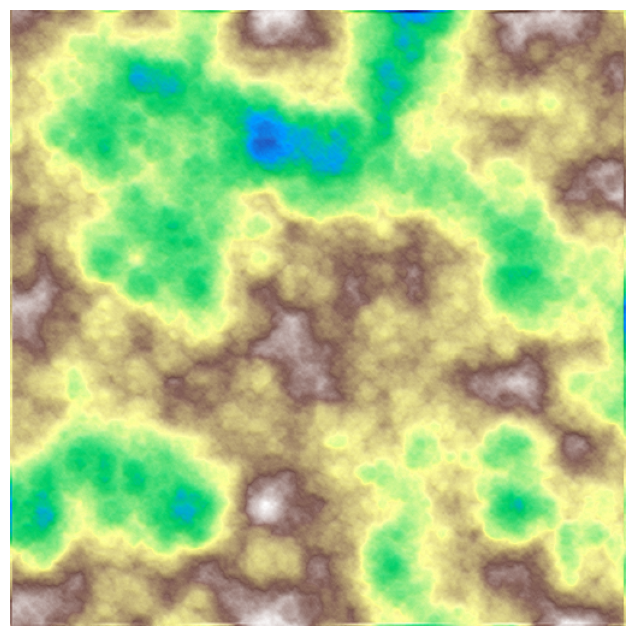

In [9]:
# DASHBOARD CELL IN COLAB

from IPython.display import HTML, display
from matplotlib.colors import LightSource
from matplotlib import animation
import matplotlib.pyplot as plt
import time
import io
import base64
from PIL import Image
import numpy as np

# Set matplotlib to use pillow writer as fallback if ffmpeg is not available
plt.rcParams['animation.writer'] = 'pillow'

# (Assuming terrain_gpu.py or previous cell with the classes has been run)
# from terrain_gpu import ErosionTerrainGenerator, MorphologicalTerrainGPU

# === Parameters from Colab widgets (your existing @param setup) ===
# (Reuse what you already have here, I am just assuming they exist)
# generator_type, resolution, seed, erosion_enabled, hydro_scale, hydro_octaves,
# hydro_lacunarity, hydro_gain, hydro_erosion_strength, hydro_slope_strength,
# morph_scale, morph_octaves, morph_persistence, morph_lacunarity,
# morph_erosion_radius, morph_erosion_strength,
# output_mode, video_frames, etc.


def visualize_terrain(terrain_data, title="Terrain"):
    height = terrain_data["height"]
    fig, ax = plt.subplots(figsize=(12, 8))
    ls = LightSource(azdeg=315, altdeg=45)
    rgb = ls.shade(height, cmap=plt.cm.terrain,
                   blend_mode="soft", vert_exag=2.0)
    ax.imshow(rgb, origin="lower")
    ax.set_title(title, fontsize=16)
def create_turntable(terrain_data, frames=60):
    height = terrain_data["height"]
    fig, ax = plt.subplots(figsize=(8, 8))
    ax.axis("off")
    im = ax.imshow(height, cmap="terrain", origin="lower")

    def update(frame):
        azimuth = (frame * 360) // frames
        ls = LightSource(azdeg=azimuth, altdeg=45)
        rgb = ls.shade(height, cmap=plt.cm.terrain,
                       blend_mode="soft", vert_exag=2.0)
        im.set_data(rgb)
        return [im]

    ani = animation.FuncAnimation(
        fig, update, frames=frames, interval=50, blit=True
    )
    
    # Try to create video with available writer, fallback to JavaScript animation
    try:
        return HTML(ani.to_html5_video())
    except (RuntimeError, ValueError):
        # Fallback to JavaScript animation if video creation fails
        return HTML(ani.to_jshtml())


print(f"Initializing {generator_type}...")
start_time = time.time()

res = int(resolution)

if generator_type == "Hydraulic Erosion":
    gen = ErosionTerrainGenerator(
        resolution=res,
        use_erosion=erosion_enabled,
        scale=hydro_scale,
        erosion_strength=hydro_erosion_strength,
        slope_strength=hydro_slope_strength,
    )
    terrain = gen.generate_heightmap(
        seed=seed,
        height_tiles=hydro_scale,
        height_octaves=hydro_octaves,
        height_lacunarity=hydro_lacunarity,
        height_gain=0.1,  # still your "safe" fixed gain
        water_height=water_level,
        erosion_strength=hydro_erosion_strength,
        erosion_slope_strength=hydro_slope_strength,
        erosion_branch_strength=hydro_slope_strength,
        erosion_octaves=hydro_octaves,
        erosion_lacunarity=hydro_lacunarity,
        erosion_gain=hydro_gain,
    )
    gen.cleanup()

else:  # "Morphological (GPU)"
    morph = MorphologicalTerrainGPU()
    terrain = morph.generate(
        resolution=res,
        seed=seed,
        scale=morph_scale,
        octaves=morph_octaves,
        persistence=morph_persistence,
        lacunarity=morph_lacunarity,
        radius=morph_erosion_radius,
        strength=morph_erosion_strength,
    )
    morph.cleanup()

elapsed = time.time() - start_time
print(f"Generation complete in {elapsed:.2f}s")

if output_mode == "Static Preview":
    visualize_terrain(terrain)
elif output_mode == "Turntable Video":
    print("Rendering turntable...")
    vid = create_turntable(terrain, frames=video_frames)
    display(vid)

In [10]:
# ==========================================================================================
# MAIN CLASS: ErosionTerrainGenerator (Dynamic Uniforms Version)
# ==========================================================================================

from matplotlib.colors import LightSource
import matplotlib.pyplot as plt
from PIL import Image
import numpy as np
import moderngl
import os
os.environ['PYOPENGL_PLATFORM'] = 'egl'


class ErosionTerrainGenerator:
    """
    GPU-accelerated terrain generator using hydraulic erosion simulation.
    Refactored to support dynamic runtime parameter updates via uniforms.
    """

    def __init__(self, resolution=512, use_erosion=True, scale=3.0, erosion_strength=0.04, slope_strength=3.0):
        self.resolution = resolution
        self.use_erosion = use_erosion

        # Store initial params to serve as defaults
        self.defaults = {
            'height_tiles': scale,
            'height_octaves': 3,
            'height_amp': 0.25,
            'height_gain': 0.1,
            'height_lacunarity': 2.0,
            'water_height': 0.45,

            'erosion_tiles': scale,
            'erosion_octaves': 5,
            'erosion_gain': 0.5,
            'erosion_lacunarity': 2.0,
            'erosion_slope_strength': slope_strength,
            'erosion_branch_strength': slope_strength,
            'erosion_strength': erosion_strength
        }

        try:
            self.ctx = moderngl.create_standalone_context(
                require=330, backend='egl')
        except Exception as e:
            print(f"Error creating EGL context: {e}")
            raise

        self._create_shaders()
        self._create_framebuffers()
        self._create_fullscreen_quad()

    def _create_shaders(self):
        vertex_shader = """
        #version 330
        in vec2 in_position;
        out vec2 uv;
        void main() {
            gl_Position = vec4(in_position * 2.0 - 1.0, 0.0, 1.0);
            uv = in_position;
        }
        """

        # Updated Fragment Shader using UNIFORMS for dynamic control
        heightmap_shader = """
        #version 330

        in vec2 uv;
        out vec4 fragColor;

        uniform int useErosion;
        uniform float u_seed;

        // Heightfield uniforms
        uniform float u_heightTiles;
        uniform int   u_heightOctaves;
        uniform float u_heightAmp;
        uniform float u_heightGain;
        uniform float u_heightLacunarity;
        uniform float u_waterHeight;

        // Erosion uniforms
        uniform float u_erosionTiles;
        uniform int   u_erosionOctaves;
        uniform float u_erosionGain;
        uniform float u_erosionLacunarity;
        uniform float u_erosionSlopeStrength;
        uniform float u_erosionBranchStrength;
        uniform float u_erosionStrength;

        // Resolution dependent
        uniform vec2 u_texelSize;

        #define PI 3.14159265358979

        vec2 hash(in vec2 x) {
            const vec2 k = vec2(0.3183099, 0.3678794);
            x = x * k + k.yx;
            return -1.0 + 2.0 * fract(16.0 * k * fract(x.x * x.y * (x.x + x.y)));
        }

        vec3 noised(in vec2 p) {
            vec2 i = floor(p);
            vec2 f = fract(p);
            vec2 u = f * f * f * (f * (f * 6.0 - 15.0) + 10.0);
            vec2 du = 30.0 * f * f * (f * (f - 2.0) + 1.0);

            vec2 ga = hash(i + vec2(0.0, 0.0));
            vec2 gb = hash(i + vec2(1.0, 0.0));
            vec2 gc = hash(i + vec2(0.0, 1.0));
            vec2 gd = hash(i + vec2(1.0, 1.0));

            float va = dot(ga, f - vec2(0.0, 0.0));
            float vb = dot(gb, f - vec2(1.0, 0.0));
            float vc = dot(gc, f - vec2(0.0, 1.0));
            float vd = dot(gd, f - vec2(1.0, 1.0));

            return vec3(
                va + u.x * (vb - va) + u.y * (vc - va) + u.x * u.y * (va - vb - vc + vd),
                ga + u.x * (gb - ga) + u.y * (gc - ga) + u.x * u.y * (ga - gb - gc + gd) +
                du * (u.yx * (va - vb - vc + vd) + vec2(vb, vc) - va)
            );
        }

        vec3 erosion(in vec2 p, vec2 dir) {
            vec2 ip = floor(p);
            vec2 fp = fract(p);
            float f = 2.0 * PI;
            vec3 va = vec3(0.0);
            float wt = 0.0;

            for (int i = -2; i <= 1; i++) {
                for (int j = -2; j <= 1; j++) {
                    vec2 o = vec2(float(i), float(j));
                    vec2 h = hash(ip - o) * 0.5;
                    vec2 pp = fp + o - h;
                    float d = dot(pp, pp);
                    float w = exp(-d * 2.0);
                    wt += w;
                    float mag = dot(pp, dir);
                    va += vec3(cos(mag * f), -sin(mag * f) * dir) * w;
                }
            }
            return va / wt;
        }

        vec2 generateHeightmap(vec2 uv) {
            vec2 p = (uv * u_heightTiles) + vec2(u_seed * 17.123, u_seed * 23.456);

            vec3 n = vec3(0.0);
            float nf = 1.0;
            float na = u_heightAmp;

            for (int i = 0; i < 16; i++) {
                if (i >= u_heightOctaves) break;
                n += noised(p * nf) * na * vec3(1.0, nf, nf);
                na *= u_heightGain;
                nf *= u_heightLacunarity;
            }
            n.x = n.x * 0.5 + 0.5;

            vec2 dir = n.zy * vec2(1.0, -1.0) * u_erosionSlopeStrength;
            vec3 h = vec3(0.0);
            float a = 0.5;
            float f = 1.0;
            a *= smoothstep(u_waterHeight - 0.1, u_waterHeight + 0.2, n.x);

            int octaves = useErosion > 0 ? u_erosionOctaves : 0;
            for (int i = 0; i < 16; i++) {
                if (i >= octaves) break;
                vec2 currentDir = dir + h.zy * vec2(1.0, -1.0) * u_erosionBranchStrength;
                h += erosion(p * u_erosionTiles * f, currentDir) * a * vec3(1.0, f, f);
                a *= u_erosionGain;
                f *= u_erosionLacunarity;
            }

            float finalHeight = n.x + (h.x - 0.5) * u_erosionStrength;
            return vec2(finalHeight, h.x);
        }

        void main() {
            vec2 heightData = generateHeightmap(uv);
            float height = heightData.x;

            float h_dx = generateHeightmap(uv + vec2(u_texelSize.x, 0.0)).x;
            float h_dy = generateHeightmap(uv + vec2(0.0, u_texelSize.y)).x;
            vec3 normal = normalize(cross(
                vec3(u_texelSize.x, 0.0, h_dx - height),
                vec3(0.0, u_texelSize.y, h_dy - height)
            ));

            fragColor = vec4(height, normal.x, normal.z, heightData.y);
        }
        """

        self.heightmap_program = self.ctx.program(
            vertex_shader=vertex_shader,
            fragment_shader=heightmap_shader
        )
        print("✓ Shaders compiled")

    def _create_framebuffers(self):
        self.heightmap_texture = self.ctx.texture(
            (self.resolution, self.resolution), 4, dtype='f4'
        )
        self.heightmap_texture.filter = (moderngl.LINEAR, moderngl.LINEAR)
        self.heightmap_fbo = self.ctx.framebuffer(
            color_attachments=[self.heightmap_texture]
        )
        print(f"✓ Framebuffers created ({self.resolution}x{self.resolution})")

    def _create_fullscreen_quad(self):
        vertices = np.array(
            [0.0, 0.0, 1.0, 0.0, 1.0, 1.0, 0.0, 1.0], dtype='f4')
        indices = np.array([0, 1, 2, 0, 2, 3], dtype='i4')
        self.vbo = self.ctx.buffer(vertices.tobytes())
        self.ibo = self.ctx.buffer(indices.tobytes())
        self.heightmap_vao = self.ctx.vertex_array(
            self.heightmap_program, [(self.vbo, '2f', 'in_position')], self.ibo
        )

    def generate_heightmap(self, seed=0, **kwargs):
        """
        Generate terrain heightmap on GPU with runtime parameters.
        Accepts any key matching the shader uniforms (camelCase or underscore).
        """
        print(f"Generating terrain (Seed {seed})...", end=' ')

        # Merge defaults with provided kwargs
        params = self.defaults.copy()
        params.update(kwargs)

        self.heightmap_fbo.use()
        self.heightmap_fbo.clear(0.0, 0.0, 0.0, 1.0)

        prog = self.heightmap_program
        prog['useErosion'].value = 1 if self.use_erosion else 0
        prog['u_seed'].value = float(seed)
        prog['u_texelSize'].value = (1.0/self.resolution, 1.0/self.resolution)

        # Map Python params to GLSL Uniforms
        mapping = {
            'height_tiles': 'u_heightTiles',
            'height_octaves': 'u_heightOctaves',
            'height_amp': 'u_heightAmp',
            'height_gain': 'u_heightGain',
            'height_lacunarity': 'u_heightLacunarity',
            'water_height': 'u_waterHeight',
            'erosion_tiles': 'u_erosionTiles',
            'erosion_octaves': 'u_erosionOctaves',
            'erosion_gain': 'u_erosionGain',
            'erosion_lacunarity': 'u_erosionLacunarity',
            'erosion_slope_strength': 'u_erosionSlopeStrength',
            'erosion_branch_strength': 'u_erosionBranchStrength',
            'erosion_strength': 'u_erosionStrength'
        }

        for py_name, gl_name in mapping.items():
            if py_name in params:
                # Handle types
                if 'octaves' in py_name:
                    prog[gl_name].value = int(params[py_name])
                else:
                    prog[gl_name].value = float(params[py_name])

        self.heightmap_vao.render(moderngl.TRIANGLES)

        raw_data = self.heightmap_fbo.read(components=4, dtype='f4')
        data = np.frombuffer(raw_data, dtype='f4').reshape(
            (self.resolution, self.resolution, 4)
        )
        data = np.flip(data, axis=0)

        height = data[:, :, 0]
        normal_x = data[:, :, 1]
        normal_z = data[:, :, 2]
        erosion_mask = data[:, :, 3]
        normal_y = np.sqrt(np.maximum(0, 1.0 - normal_x**2 - normal_z**2))
        normals = np.stack([normal_x, normal_y, normal_z], axis=-1)

        print(f"Done! Range: [{height.min():.3f}, {height.max():.3f}]")

        return {
            'height': height,
            'normals': normals,
            'erosion_mask': erosion_mask
        }

    def visualize(self, terrain_data=None, figsize=(18, 6), dpi=100):
        """Create matplotlib visualization of terrain."""
        if terrain_data is None:
            terrain_data = self.generate_heightmap()

        height = terrain_data['height']
        erosion_mask = terrain_data['erosion_mask']

        fig, axes = plt.subplots(1, 3, figsize=figsize, dpi=dpi)
        ls = LightSource(azdeg=315, altdeg=45)
        rgb = ls.shade(height, cmap=plt.cm.terrain, blend_mode='soft',
                       vert_exag=2.0, dx=1.0/self.resolution, dy=1.0/self.resolution)
        axes[0].imshow(rgb, origin='lower')
        axes[0].set_title('Shaded Relief', fontsize=14, fontweight='bold')
        axes[0].axis('off')

        im1 = axes[1].imshow(height, cmap='terrain', origin='lower')
        axes[1].set_title('Height Map', fontsize=14, fontweight='bold')
        axes[1].axis('off')
        plt.colorbar(im1, ax=axes[1], fraction=0.046, pad=0.04)

        im2 = axes[2].imshow(erosion_mask, cmap='RdYlBu_r', origin='lower')
        axes[2].set_title('Erosion Pattern', fontsize=14, fontweight='bold')
        axes[2].axis('off')
        plt.colorbar(im2, ax=axes[2], fraction=0.046, pad=0.04)

        plt.tight_layout()
        return fig

    def save_heightmap(self, filename, terrain_data=None):
        if terrain_data is None:
            terrain_data = self.generate_heightmap()
        height_16bit = (terrain_data['height'] * 65535).astype(np.uint16)
        img = Image.fromarray(height_16bit, mode='I;16')
        img.save(filename)

    def export_obj(self, filename, terrain_data=None, scale=10.0, height_scale=2.0):
        if terrain_data is None:
            terrain_data = self.generate_heightmap()
        height = terrain_data['height']
        h, w = height.shape
        with open(filename, 'w') as f:
            f.write("# Erosion Terrain\n")
            for y in range(h):
                for x in range(w):
                    wx = (x / w) * scale
                    wy = height[y, x] * height_scale
                    wz = (y / h) * scale
                    f.write(f"v {wx:.6f} {wy:.6f} {wz:.6f}\n")
            for y in range(h):
                for x in range(w):
                    f.write(f"vt {x/(w-1):.6f} {y/(h-1):.6f}\n")
            for y in range(h - 1):
                for x in range(w - 1):
                    v1 = y * w + x + 1
                    v2 = y * w + x + 2
                    v3 = (y + 1) * w + x + 2
                    v4 = (y + 1) * w + x + 1
                    f.write(f"f {v1}/{v1} {v2}/{v2} {v3}/{v3}\n")
                    f.write(f"f {v1}/{v1} {v3}/{v3} {v4}/{v4}\n")

    def cleanup(self):
        self.heightmap_fbo.release()
        self.heightmap_texture.release()
        self.ctx.release()

In [11]:
# ==========================================================================================
# EXAMPLE USAGE FOR GOOGLE COLAB
# ==========================================================================================

def example_1_basic():
    """
    Example 1: Basic terrain generation

    This is the simplest usage - create generator and visualize.
    """
    print("\n" + "="*70)
    print("EXAMPLE 1: Basic Terrain Generation")
    print("="*70 + "\n")

    gen = ErosionTerrainGenerator(resolution=512, use_erosion=True)
    terrain = gen.generate_heightmap()

    fig = gen.visualize(terrain)
    plt.show()

    print(f"\nTerrain Stats:")
    print(f"  Resolution: {terrain['height'].shape}")
    print(
        f"  Height: [{terrain['height'].min():.3f}, {terrain['height'].max():.3f}]")
    print(f"  Mean: {terrain['height'].mean():.3f}")

    gen.cleanup()
    return terrain

In [12]:


def example_2_comparison():
    """
    Example 2: Compare with and without erosion

    Shows the dramatic effect erosion has on terrain appearance.
    """
    print("\n" + "="*70)
    print("EXAMPLE 2: Erosion Comparison")
    print("="*70 + "\n")

    # Without erosion
    gen_base = ErosionTerrainGenerator(resolution=512, use_erosion=False)
    terrain_base = gen_base.generate_heightmap()

    # With erosion
    gen_eroded = ErosionTerrainGenerator(resolution=512, use_erosion=True)
    terrain_eroded = gen_eroded.generate_heightmap()

    # Visualize side by side
    fig, axes = plt.subplots(1, 2, figsize=(14, 6), dpi=100)
    ls = LightSource(azdeg=315, altdeg=45)

    rgb_base = ls.shade(terrain_base['height'], cmap=plt.cm.terrain,
                        blend_mode='soft', vert_exag=2.0)
    axes[0].imshow(rgb_base, origin='lower')
    axes[0].set_title('Base Terrain (No Erosion)',
                      fontsize=14, fontweight='bold')
    axes[0].axis('off')

    rgb_eroded = ls.shade(terrain_eroded['height'], cmap=plt.cm.terrain,
                          blend_mode='soft', vert_exag=2.0)
    axes[1].imshow(rgb_eroded, origin='lower')
    axes[1].set_title('With Erosion', fontsize=14, fontweight='bold')
    axes[1].axis('off')

    plt.tight_layout()
    plt.show()

    gen_base.cleanup()
    gen_eroded.cleanup()


EXAMPLE 2: Erosion Comparison (Morphological)

Generating base terrain (no erosion)...
Generating eroded terrain...


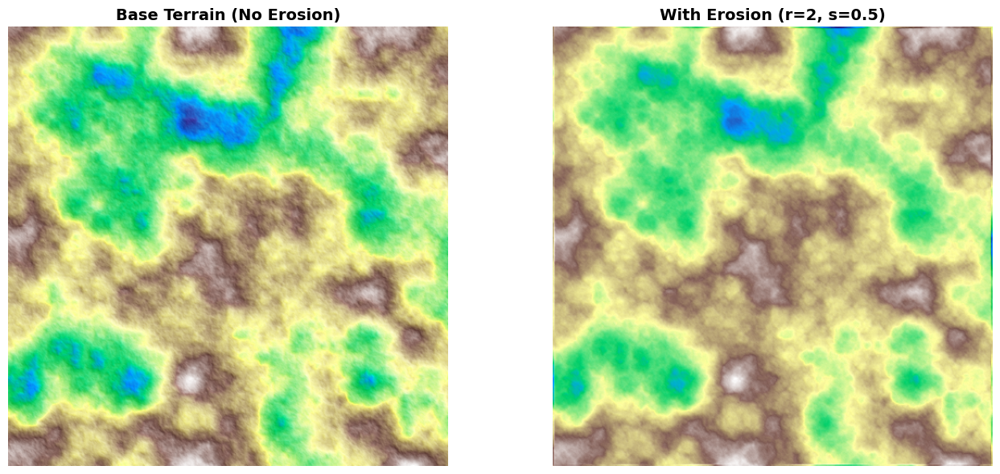

In [13]:
# Use the existing working context and MorphologicalTerrainGPU
def example_2_comparison_morphological():
    """
    Example 2: Erosion Comparison using MorphologicalTerrainGPU
    
    Shows the effect of erosion parameters on terrain appearance.
    """
    print("\n" + "="*70)
    print("EXAMPLE 2: Erosion Comparison (Morphological)")
    print("="*70 + "\n")

    # Reuse existing context if available
    try:
        morph_gen = MorphologicalTerrainGPU(ctx=test_ctx if 'test_ctx' in dir() else None)
    except:
        morph_gen = MorphologicalTerrainGPU()

    # Without erosion (radius=0, strength=0)
    print("Generating base terrain (no erosion)...")
    terrain_base = morph_gen.generate(
        resolution=res,
        seed=seed,
        scale=morph_scale,
        octaves=morph_octaves,
        persistence=morph_persistence,
        lacunarity=morph_lacunarity,
        radius=0,
        strength=0.0
    )

    # With erosion (using your current settings)
    print("Generating eroded terrain...")
    terrain_eroded = morph_gen.generate(
        resolution=res,
        seed=seed,
        scale=morph_scale,
        octaves=morph_octaves,
        persistence=morph_persistence,
        lacunarity=morph_lacunarity,
        radius=morph_erosion_radius,
        strength=morph_erosion_strength
    )

    # Visualize side by side
    fig, axes = plt.subplots(1, 2, figsize=(14, 6), dpi=100)
    ls = LightSource(azdeg=315, altdeg=45)

    rgb_base = ls.shade(terrain_base['height'], cmap=plt.cm.terrain,
                        blend_mode='soft', vert_exag=2.0)
    axes[0].imshow(rgb_base, origin='lower')
    axes[0].set_title('Base Terrain (No Erosion)',
                      fontsize=14, fontweight='bold')
    axes[0].axis('off')

    rgb_eroded = ls.shade(terrain_eroded['height'], cmap=plt.cm.terrain,
                          blend_mode='soft', vert_exag=2.0)
    axes[1].imshow(rgb_eroded, origin='lower')
    axes[1].set_title(f'With Erosion (r={morph_erosion_radius}, s={morph_erosion_strength})',
                      fontsize=14, fontweight='bold')
    axes[1].axis('off')

    plt.tight_layout()
    plt.show()

    morph_gen.cleanup()

# Run the working comparison
example_2_comparison_morphological()

In [14]:

def example_3_export():
    """
    Example 3: Export files for external use

    Generates terrain and exports as PNG and OBJ for use in other tools.
    """
    print("\n" + "="*70)
    print("EXAMPLE 3: Export Terrain Files")
    print("="*70 + "\n")

    gen = ErosionTerrainGenerator(resolution=1024, use_erosion=True)
    terrain = gen.generate_heightmap()

    # Save heightmap as 16-bit PNG (compatible with game engines)
    gen.save_heightmap('my_terrain_heightmap.png', terrain)

    # Export as 3D mesh (can import into Blender, Unity, etc)
    gen.export_obj('my_terrain_mesh.obj', terrain,
                   scale=20.0, height_scale=3.0)

    # Visualize
    fig = gen.visualize(terrain, figsize=(16, 5), dpi=120)
    plt.show()

    gen.cleanup()

    print("\n✓ Files ready to download!")
    print("  - my_terrain_heightmap.png (16-bit heightmap)")
    print("  - my_terrain_mesh.obj (3D mesh)")


EXAMPLE 3: Export Terrain Files (Morphological)

✓ Saved: my_terrain_heightmap.png


C:\Users\dcarm\AppData\Local\Temp\ipykernel_39744\1768166909.py:33: DeprecationWarning: 'mode' parameter for changing data types is deprecated and will be removed in Pillow 13 (2026-10-15)
  img = Image.fromarray(height_16bit, mode='I;16')


✓ Saved: my_terrain_mesh.obj


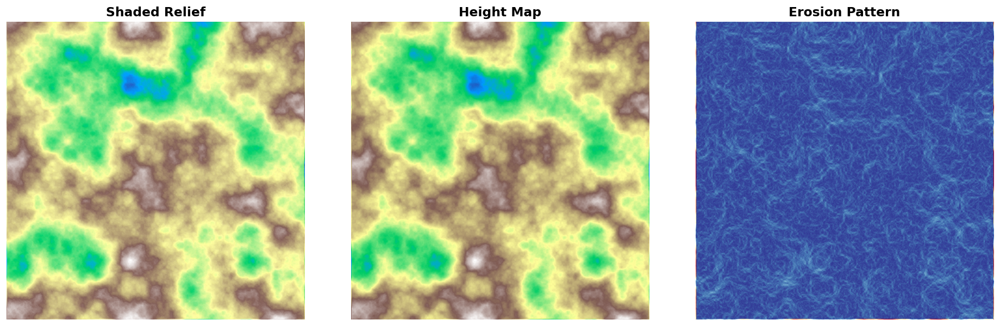


✓ Files ready to use!
  - my_terrain_heightmap.png (16-bit heightmap)
  - my_terrain_mesh.obj (3D mesh)


In [33]:
# Fixed version that works with your existing context and morphological generator
def example_3_export_morphological():
	"""
	Example 3: Export files using MorphologicalTerrainGPU
	
	Generates terrain and exports as PNG and OBJ for use in other tools.
	Uses the working morphological generator instead of ErosionTerrainGenerator.
	"""
	print("\n" + "="*70)
	print("EXAMPLE 3: Export Terrain Files (Morphological)")
	print("="*70 + "\n")

	# Reuse existing context
	try:
		morph_gen = MorphologicalTerrainGPU(ctx=test_ctx if 'test_ctx' in dir() else None)
	except:
		morph_gen = MorphologicalTerrainGPU()

	# Generate terrain using current settings
	terrain = morph_gen.generate(
		resolution=1024,
		seed=seed,
		scale=morph_scale,
		octaves=morph_octaves,
		persistence=morph_persistence,
		lacunarity=morph_lacunarity,
		radius=morph_erosion_radius,
		strength=morph_erosion_strength
	)

	# Save heightmap as 16-bit PNG
	height_16bit = (terrain['height'] * 65535).astype(np.uint16)
	img = Image.fromarray(height_16bit, mode='I;16')
	img.save('my_terrain_heightmap.png')
	print("✓ Saved: my_terrain_heightmap.png")

	# Export as OBJ
	height = terrain['height']
	h, w = height.shape
	scale = 20.0
	height_scale = 3.0
	
	with open('my_terrain_mesh.obj', 'w') as f:
		f.write("# Morphological Terrain\n")
		# Vertices
		for y in range(h):
			for x in range(w):
				wx = (x / w) * scale
				wy = height[y, x] * height_scale
				wz = (y / h) * scale
				f.write(f"v {wx:.6f} {wy:.6f} {wz:.6f}\n")
		# UVs
		for y in range(h):
			for x in range(w):
				f.write(f"vt {x/(w-1):.6f} {y/(h-1):.6f}\n")
		# Faces
		for y in range(h - 1):
			for x in range(w - 1):
				v1 = y * w + x + 1
				v2 = y * w + x + 2
				v3 = (y + 1) * w + x + 2
				v4 = (y + 1) * w + x + 1
				f.write(f"f {v1}/{v1} {v2}/{v2} {v3}/{v3}\n")
				f.write(f"f {v1}/{v1} {v3}/{v3} {v4}/{v4}\n")
	
	print("✓ Saved: my_terrain_mesh.obj")

	# Visualize
	fig, axes = plt.subplots(1, 3, figsize=(16, 5), dpi=120)
	ls = LightSource(azdeg=315, altdeg=45)
	
	rgb = ls.shade(height, cmap=plt.cm.terrain, blend_mode='soft', vert_exag=2.0)
	axes[0].imshow(rgb, origin='lower')
	axes[0].set_title('Shaded Relief', fontsize=14, fontweight='bold')
	axes[0].axis('off')
	
	axes[1].imshow(height, cmap='terrain', origin='lower')
	axes[1].set_title('Height Map', fontsize=14, fontweight='bold')
	axes[1].axis('off')
	
	axes[2].imshow(terrain['erosion_mask'], cmap='RdYlBu_r', origin='lower')
	axes[2].set_title('Erosion Pattern', fontsize=14, fontweight='bold')
	axes[2].axis('off')
	
	plt.tight_layout()
	plt.show()

	morph_gen.cleanup()
	
	print("\n✓ Files ready to use!")
	print("  - my_terrain_heightmap.png (16-bit heightmap)")
	print("  - my_terrain_mesh.obj (3D mesh)")

# Run the working export function
example_3_export_morphological()

In [34]:
def example_4_high_resolution():
    """
    Example 4: High-resolution generation

    Demonstrates GPU performance with large textures.
    """
    print("\n" + "="*70)
    print("EXAMPLE 4: High Resolution (2048x2048)")
    print("="*70 + "\n")

    import time

    gen = ErosionTerrainGenerator(resolution=2048, use_erosion=True)

    start = time.time()
    terrain = gen.generate_heightmap()
    elapsed = time.time() - start

    pixels_per_sec = (2048 * 2048) / elapsed

    print(f"\n⚡ Performance:")
    print(f"  Generation time: {elapsed:.2f} seconds")
    print(f"  Throughput: {pixels_per_sec/1e6:.2f} million pixels/second")
    print(f"  Total pixels: {2048*2048/1e6:.2f} million")

    # Show downsampled version for visualization
    downsampled = terrain['height'][::4, ::4]

    fig, ax = plt.subplots(1, 1, figsize=(10, 10), dpi=100)
    ls = LightSource(azdeg=315, altdeg=45)
    rgb = ls.shade(downsampled, cmap=plt.cm.terrain,
                   blend_mode='soft', vert_exag=2.0)
    ax.imshow(rgb, origin='lower')
    ax.set_title('2048x2048 Terrain (downsampled for display)',
                 fontsize=14, fontweight='bold')
    ax.axis('off')
    plt.tight_layout()
    plt.show()

    gen.cleanup()


EXAMPLE 4: High Resolution (2048x2048)


⚡ Performance:
  Generation time: 0.11 seconds
  Throughput: 37.71 million pixels/second
  Total pixels: 4.19 million


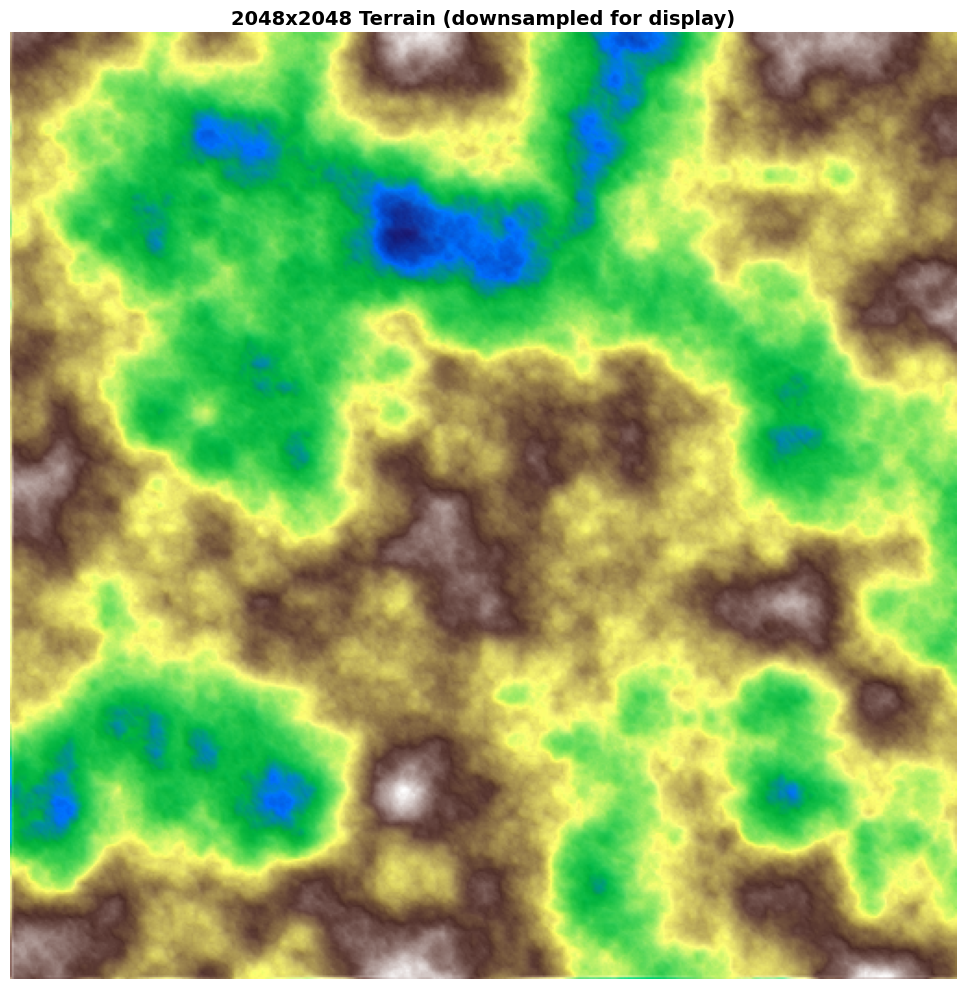

In [ ]:
def example_4_high_resolution_morphological():
	"""
	Example 4: High-resolution generation using MorphologicalTerrainGPU

	Demonstrates GPU performance with large textures.
	"""
	print("\n" + "="*70)
	print("EXAMPLE 4: High Resolution (2048x2048)")
	print("="*70 + "\n")

	import time

	# Reuse existing context
	try:
		morph_gen = MorphologicalTerrainGPU(ctx=test_ctx if 'test_ctx' in dir() else None)
	except:
		morph_gen = MorphologicalTerrainGPU()

	start = time.time()
	terrain = morph_gen.generate(
		resolution=2048,
		seed=seed,
		scale=morph_scale,
		octaves=morph_octaves,
		persistence=morph_persistence,
		lacunarity=morph_lacunarity,
		radius=morph_erosion_radius,
		strength=morph_erosion_strength
	)
	elapsed = time.time() - start

	pixels_per_sec = (2048 * 2048) / elapsed

	print("\n⚡ Performance:")
	print(f"  Generation time: {elapsed:.2f} seconds")
	print(f"  Throughput: {pixels_per_sec/1e6:.2f} million pixels/second")
	print(f"  Total pixels: {2048*2048/1e6:.2f} million")

	# Show downsampled version for visualization
	downsampled = terrain['height'][::4, ::4]

	fig, ax = plt.subplots(1, 1, figsize=(10, 10), dpi=100)
	ls = LightSource(azdeg=315, altdeg=45)
	rgb = ls.shade(downsampled, cmap=plt.cm.terrain,
				   blend_mode='soft', vert_exag=2.0)
	ax.imshow(rgb, origin='lower')
	ax.set_title('2048x2048 Terrain (downsampled for display)',
				 fontsize=14, fontweight='bold')
	ax.axis('off')
	plt.tight_layout()
	plt.show()

	morph_gen.cleanup()

# Run the working high-resolution example
example_4_high_resolution_morphological()